In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import os
os.chdir('/content/drive/MyDrive/CV5/utils')

In [4]:
import numpy as np
import torch
import torch.utils.data
from PIL import Image
import pandas as pd

from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import torchvision

from PIL.ExifTags import TAGS
from engine import train_one_epoch, evaluate
import utils
from torchvision import transforms as T  

In [5]:
class DataSet(torch.utils.data.Dataset):
    
    def __init__(self,root, data_file, transform):
        self.root = root ### mapa cu fotografii
        self.transform = transform
        self.data = pd.read_csv(data_file, sep=';')
        self.imgs = self.data['image_path'].values
        self.path_to_data_file = data_file
        
    def __getitem__(self,idx):
        
        img_path = os.path.join(self.root,self.imgs[idx])
        img = Image.open(img_path).convert('RGB')
        
        
        for orientation in TAGS.keys() : 
            if TAGS[orientation]=='Orientation' : break 
        # Getting the exif
        exif=dict(img.getexif().items())
        # Rotating the image if the orientation is wrong.
        if len(exif)!=0:                                                             
            if orientation in exif.keys():
                if exif[orientation] == 3 : 
                    img=img.rotate(180, expand=True)
                elif exif[orientation] == 6 : 
                    img=img.rotate(270, expand=True)
                elif exif[orientation] == 8 : 
                    img=img.rotate(90, expand=True)
                    
        box_list = self.data[self.data['image_path']==self.imgs[idx]][['x_min','y_min','x_max','y_max']].values
        boxes = torch.as_tensor(box_list, dtype=torch.float32)
        num_obj = len(box_list)
        labels = torch.ones((num_obj,), dtype = torch.int64)
        iscrowd = torch.zeros((num_obj,), dtype=torch.int64)
        area = (boxes[:,3] - boxes[:, 1]) * (boxes[:,2] - boxes[:, 0])
        
        image_id = torch.tensor([idx])
        
        target = {}
        target['boxes'] = boxes
        target['labels'] = labels
        target['area'] = area
        target['iscrowd'] = iscrowd
        target['image_id'] = image_id
        
        if self.transform is not None:
            img = self.transform(img)
        
        return img, target
    
    def __len__(self):
        return len(self.data)

In [6]:
transformations = T.Compose([T.ToTensor()])

dataset = DataSet('/content/drive/MyDrive/CV5/data',
                  '/content/drive/MyDrive/CV5/glasses2.csv',
                  transformations)

torch.manual_seed(1)

indices = torch.randperm(len(dataset)).tolist()
train = torch.utils.data.Subset(dataset, indices[:100])
test = torch.utils.data.Subset(dataset, indices[100:])

train_loader = torch.utils.data.DataLoader(train, batch_size = 1, shuffle=True, collate_fn = utils.collate_fn)
test_loader = torch.utils.data.DataLoader(test, batch_size = 1, shuffle=False, collate_fn = utils.collate_fn)

In [7]:
def get_model(num_clase):
    
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
    
    for param in model.parameters():
        param.required_grad = False
        
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_clase)
    
    return model

In [8]:
DEVICE = torch.device('cuda' if torch.cuda.is_available else 'cpu')

num_clase = 2
model = get_model(num_clase).to(DEVICE)

params  = [p for p in model.parameters() if p.requires_grad]

optimizer = torch.optim.SGD(params, lr = 0.005, momentum = 0.9, weight_decay = 0.0005)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth


  0%|          | 0.00/160M [00:00<?, ?B/s]

In [9]:
num_epoch = 5

for epoch in range(num_epoch):
    
    train_one_epoch(model, optimizer, train_loader, DEVICE, epoch, print_freq = 10)
    
    evaluate(model, test_loader, device=DEVICE)

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Epoch: [0]  [  0/100]  eta: 0:02:31  lr: 0.000055  loss: 0.7678 (0.7678)  loss_classifier: 0.7047 (0.7047)  loss_box_reg: 0.0132 (0.0132)  loss_objectness: 0.0389 (0.0389)  loss_rpn_box_reg: 0.0110 (0.0110)  time: 1.5122  data: 0.2827  max mem: 953
Epoch: [0]  [ 10/100]  eta: 0:01:26  lr: 0.000560  loss: 0.5646 (0.5228)  loss_classifier: 0.4153 (0.4140)  loss_box_reg: 0.0314 (0.0561)  loss_objectness: 0.0389 (0.0446)  loss_rpn_box_reg: 0.0077 (0.0080)  time: 0.9594  data: 0.2519  max mem: 1618
Epoch: [0]  [ 20/100]  eta: 0:01:18  lr: 0.001065  loss: 0.2028 (0.3510)  loss_classifier: 0.0986 (0.2580)  loss_box_reg: 0.0430 (0.0539)  loss_objectness: 0.0174 (0.0308)  loss_rpn_box_reg: 0.0052 (0.0083)  time: 0.9538  data: 0.2940  max mem: 1659
Epoch: [0]  [ 30/100]  eta: 0:01:08  lr: 0.001569  loss: 0.1665 (0.3062)  loss_classifier: 0.0874 (0.2102)  loss_box_reg: 0.0606 (0.0643)  loss_objectness: 0.0073 (0.0248)  loss_rpn_box_reg: 0.0038 (0.0070)  time: 0.9800  data: 0.3189  max mem: 1709
E

In [15]:
torch.save(model.state_dict(),'/content/drive/MyDrive/fix1_ports_model.pth')

In [16]:
loaded_model = get_model(num_clase=2)
loaded_model.load_state_dict(torch.load('/content/drive/MyDrive/fix1_ports_model.pth'))

<All keys matched successfully>

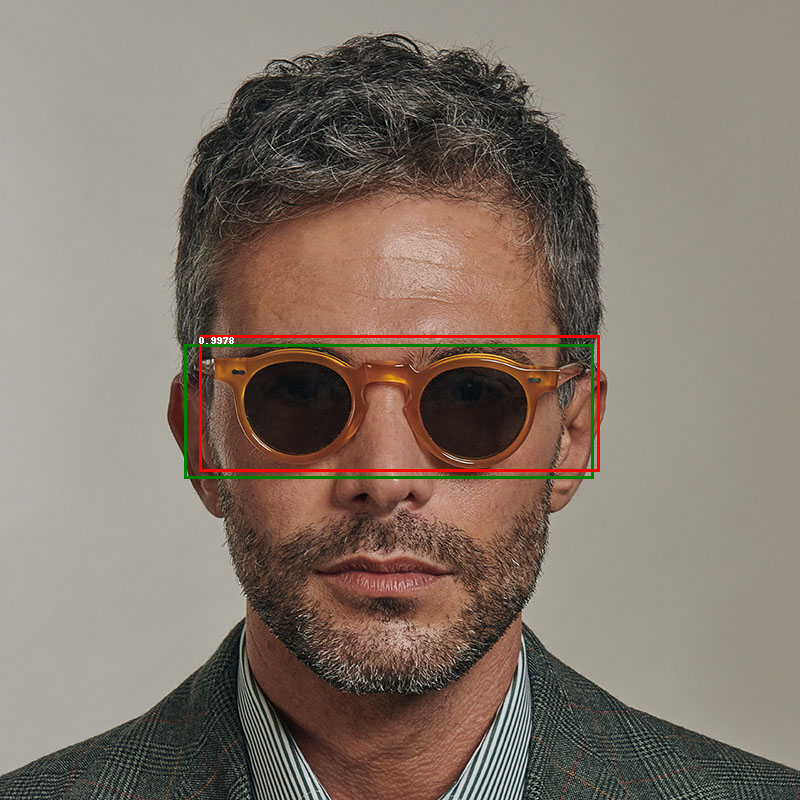

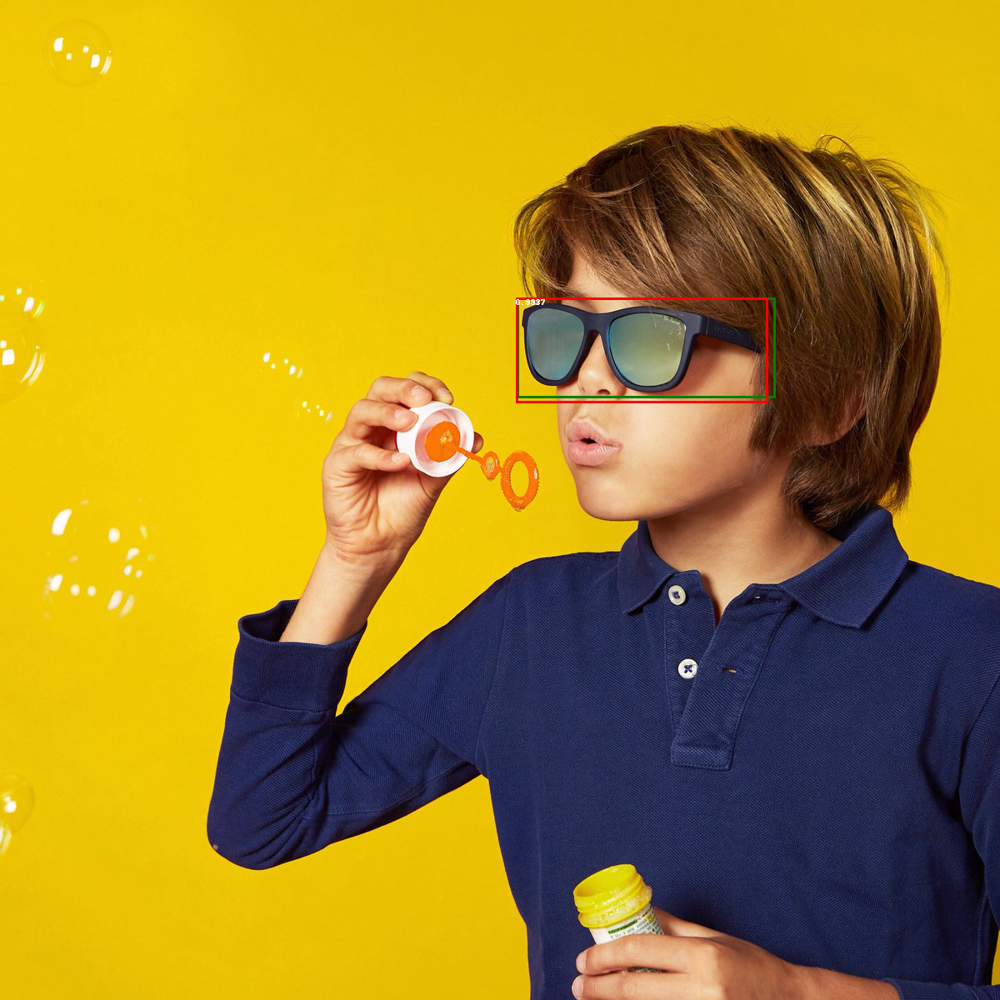

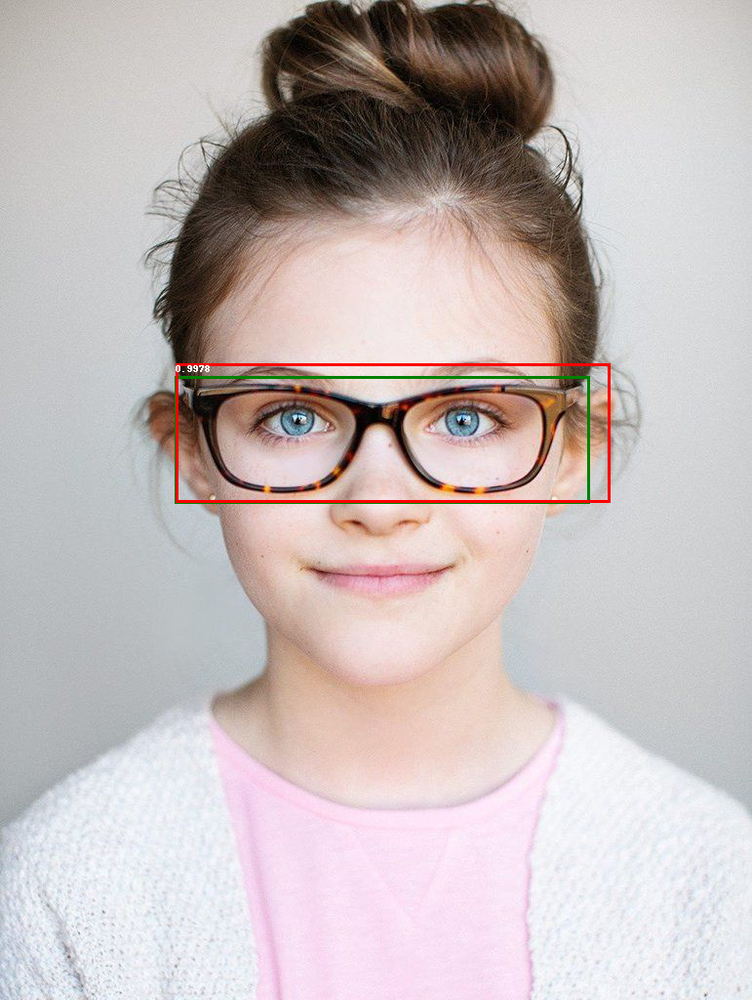

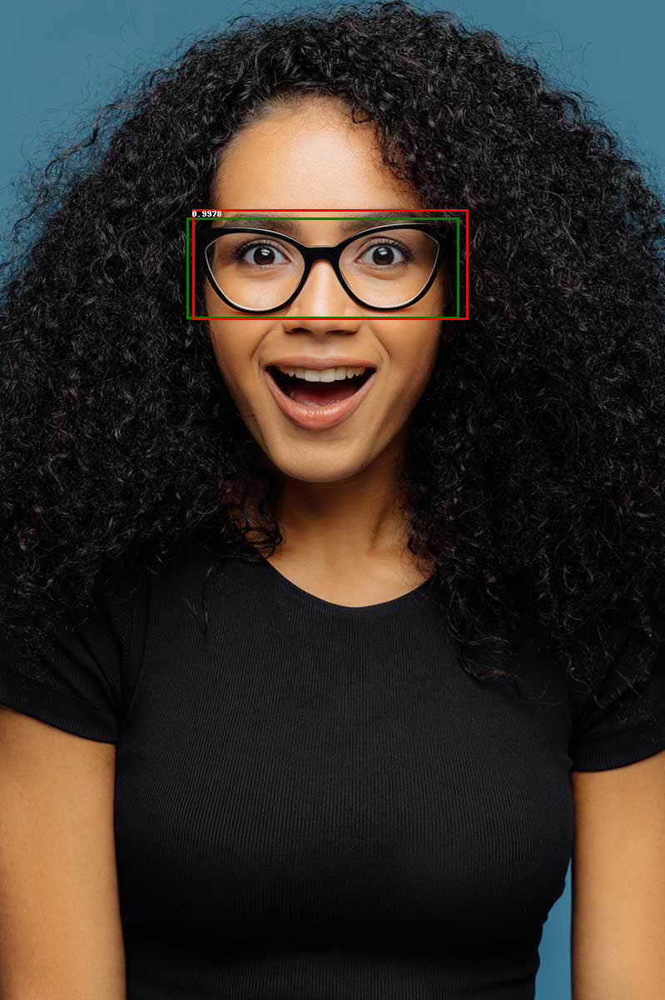

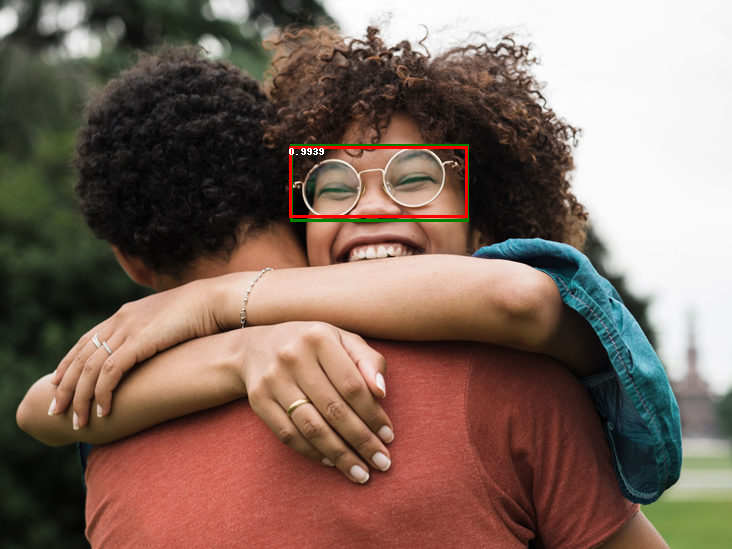

...

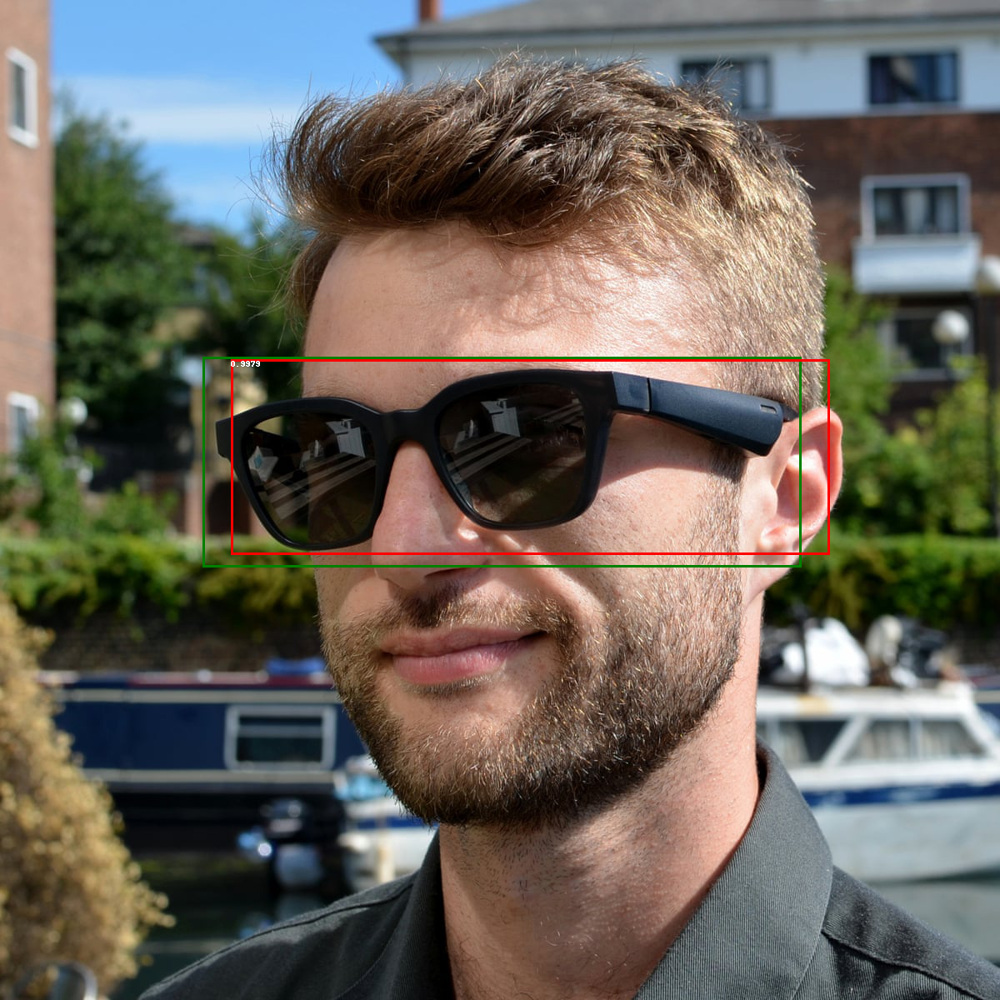

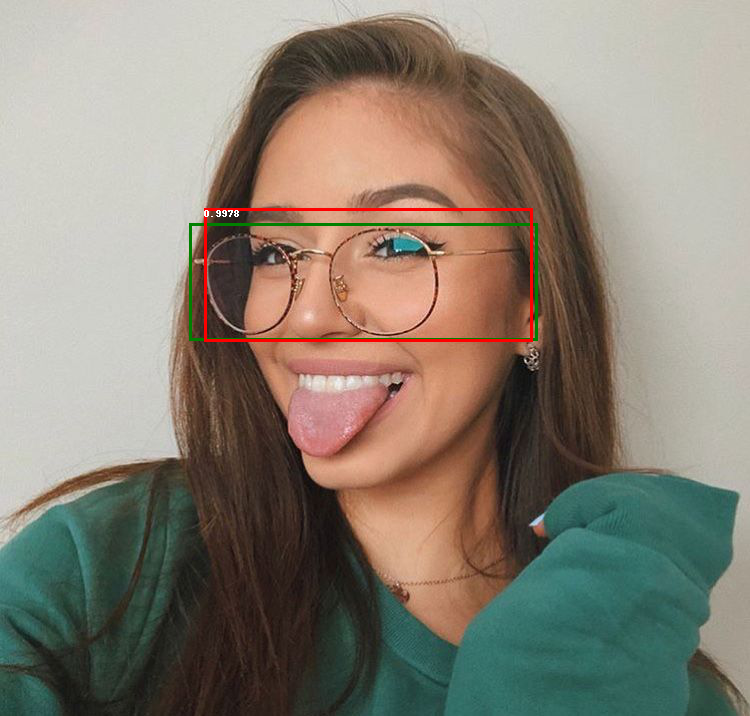

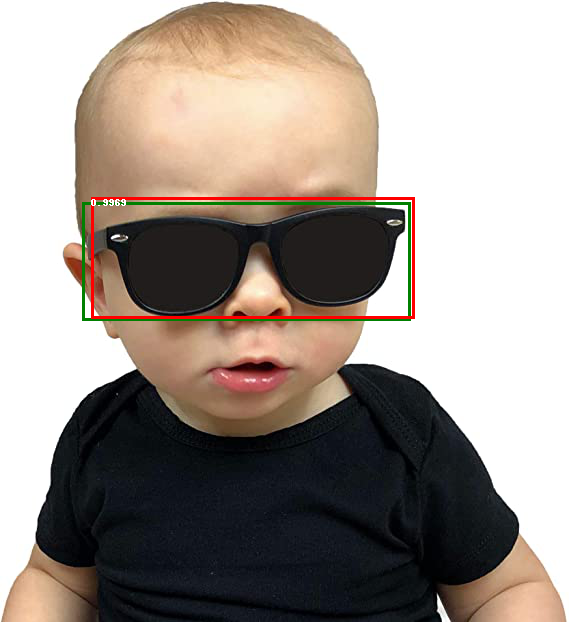

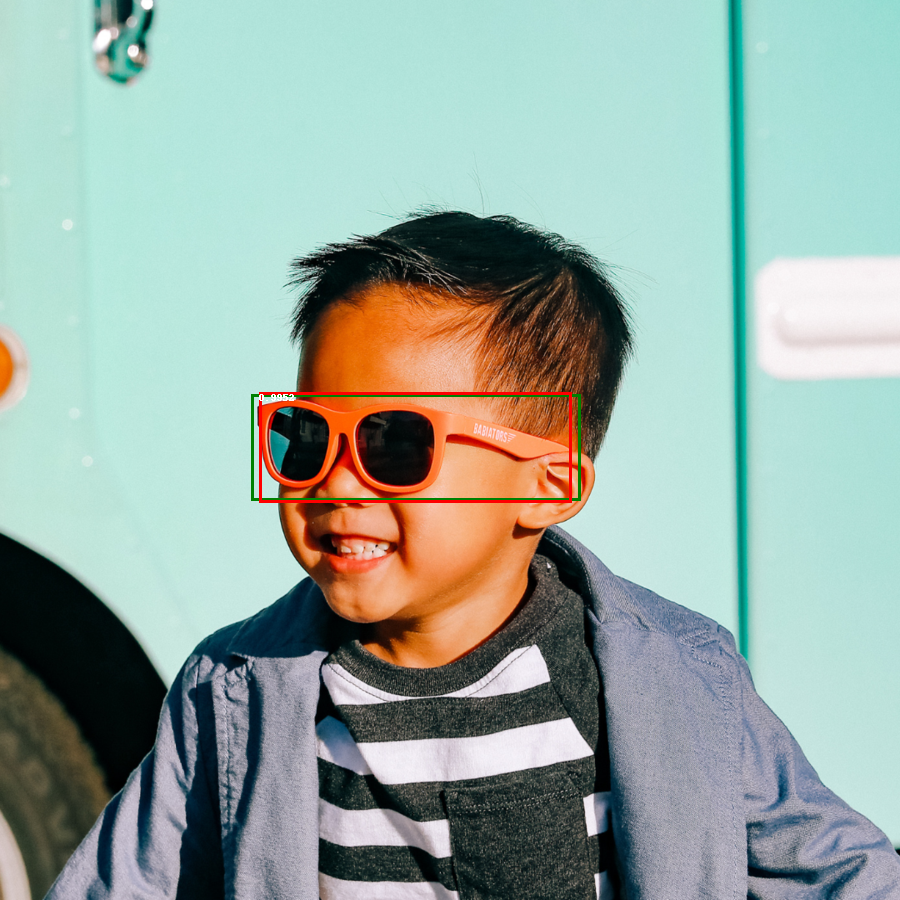

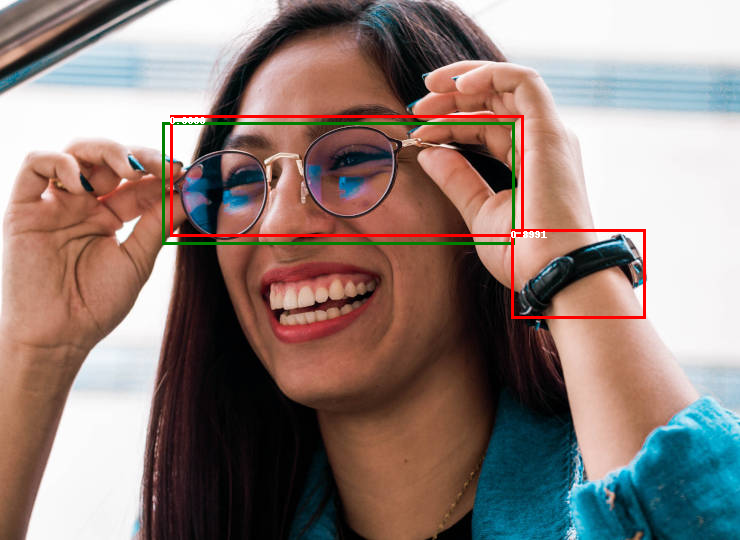

In [17]:
# Use this code to made a predition.
from PIL import ImageDraw
# Getting the image.
for idx in range(2,20):
    img, _ = test[idx]
    # Getting the object coordinates.
    label_boxes = np.array(test[idx][1]['boxes'])

    # Setting the model to eval state.
    loaded_model.eval()
    # Making the prediction.
    with torch.no_grad():
        prediction = loaded_model([img])

    # Getting an drawing the image.
    image = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
    draw = ImageDraw.Draw(image)

    # Drawing the real box around the object.
    for elem in range(len(label_boxes)):
        draw.rectangle([(label_boxes[elem][0], label_boxes[elem][1]),
                       (label_boxes[elem][2], label_boxes[elem][3])],
                      outline='green', width=3)
    # Drawing the predicted box around the object.
    for element in range(len(prediction[0]['boxes'])):
        boxes = prediction[0]['boxes'][element].cpu().numpy()                                     
        score = np.round(prediction[0]['scores'][element].cpu().numpy(), decimals=4)

        if score > 0.2:
            draw.rectangle([(boxes[0], boxes[1]), (boxes[2], boxes[3])],
                         outline='red', width=3)
            draw.text((boxes[0], boxes[1]), text=str(score))
    display(image)